In [1]:
import cv2
import matplotlib.pyplot as plt
from deep_sort_realtime.deepsort_tracker import DeepSort 
import openpifpaf as opp
from PIL import Image
import matplotlib.pyplot as plt
from deep_sort_realtime.deepsort_tracker import DeepSort
import pandas as pd
import numpy as np
from IPython.display import display
from ultralytics import YOLO
import torch
import seaborn as sns

## my funcitons
from utils.get_coordinates import get_yolov8_pose_track_coords
from utils.get_statistics import get_patterns
import utils.get_plots as pose_plots


/home/alber/anaconda3/envs/masters_env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [13]:
# video path
video_path = "../inference/video/YSU_20_sec.webm"

# devide
device = device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## YOLO

In [14]:
model = YOLO("yolov8n-pose.pt")

In [15]:
model = model.to(device)

In [16]:
results = model.track(video_path,show=True,save=True,save_dir='runs/')



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/20890) /home/alber/Desktop/DSB3/MastersThesis/HumanPoseDetection/src/../inference/video/YSU_20_sec.webm: 448x640 6 persons, 16.3ms
video 1/1 (frame 2/20890) /home/alber/Desktop/DSB3/MastersThesis/HumanPoseDetection/src/../inference/video/YSU_20_sec.webm: 448x640 6 persons, 9.7ms
video 1/1 (frame 3/20890) /home/alber/Desktop/DSB3/MastersThesis/HumanPoseDetection/src/../inference/video/YSU_20_sec.webm: 448x640 7 persons, 11.3ms
video 1

KeyboardInterrupt: 

In [2]:
# results in data frame form
# full_coords_df = get_yolov8_pose_track_coords(results,save_dir="coord_data/",file_name="yolov8_pose_tracking_ysu.csv")
full_coords_df = pd.read_csv("coord_data/yolov8_pose_tracking_ysu.csv")

In [11]:
# mean coords for id in each frame
# mean coords for each 
import numpy as np


def distance_between_keypoints(df,keypoints_1,keypoints_2):
    
    keypoint_1 = keypoints_1[0].split("_")[1]
    keypoint_2 = keypoints_2[0].split("_")[1]
    
    data = df[['Frame','ID','Landmark','Pose_X','Pose_Y']].copy()
    
    df_1 = data[data['Landmark'].isin(keypoints_1)].drop("Landmark",axis=1)
    df_2 = data[data['Landmark'].isin(keypoints_2)].drop("Landmark",axis=1)
    
    df_1 = df_1.groupby(['Frame','ID']).agg("mean").add_prefix(keypoint_1+"_mean_")
    
    x_1,y_1 = df_1.columns
    df_1.reset_index(inplace=True)
    
    df_2 = df_2.groupby(['Frame','ID']).agg("mean").add_prefix(keypoint_2+"_mean_")
    
    
    x_2,y_2 = df_2.columns
    df_2.reset_index(inplace=True)
    
    df_1_2 = df_1.merge(df_2,on=['Frame','ID'])
    
    dist_1 = 'Euclidean_'+keypoint_1+"_to_"+keypoint_2
    dist_2 = 'Manhattan_'+keypoint_1+"_to_"+keypoint_2
    
    df_1_2[dist_1] = round(np.sqrt((df_1_2[x_2]-df_1_2[x_1])**2 + (df_1_2[y_2]-df_1_2[y_1])**2))
    df_1_2[dist_2] = round(abs(df_1_2[x_2]-df_1_2[x_1]) + abs(df_1_2[y_2]-df_1_2[y_1]))
    
    df_1_2_pc_change = df_1_2.groupby("ID")[[dist_1,dist_2]].pct_change().add_prefix("p_change_").fillna(0)
    pc_change_columns = df_1_2_pc_change.columns
    
    df_1_2 = df_1_2.reset_index().merge(df_1_2_pc_change.reset_index(),on='index').drop("index",axis=1)
    
    df_1_2 = df_1_2[["Frame","ID",dist_1,dist_2]+list(pc_change_columns)]

    return df_1_2


def get_patterns(df):

    
    n_frames = df['Frame'].values[-1]+1
    unique_ids = df.ID.unique()
    n_unique_ids = len(unique_ids)
    # only rows that where any keypoint appears
    df_not_zero = df[df['LandmarkApears']].copy()


    # inidivual scores
    # ------------------------------------------------------------------------------------------------------------------------------#


    # mean for each id in each frame
    df_mean_1 = df_not_zero[['Frame','ID','Pose_X','Pose_Y']].copy()
    df_mean_1 = df_mean_1.groupby(['Frame','ID'])[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("Mean_").add_suffix("_PerID_EachFrame")\
                            .reset_index()


    # distance between face to lower limb
    df_face = df_not_zero[df_not_zero['BodyPart']=='face'].copy()
    df_lower_limbs = df_not_zero[df_not_zero['BodyPart']=='lower_limbs'].copy()
    
    df_face = df_face.groupby(['Frame','ID'])[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("Face_")\
                            .reset_index()
    df_lower_limbs = df_lower_limbs.groupby(['Frame','ID'])[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("LowerLimbs_")\
                            .reset_index()
    
    df_face_lower_limbd_distance = df_face.merge(df_lower_limbs,on=['Frame','ID'])

    # Euclidean Distance 
    df_face_lower_limbd_distance['FaceToLoerLimbs_Euclidean'] = \
                    np.sqrt((df_face_lower_limbd_distance['Face_Pose_X']-df_face_lower_limbd_distance['LowerLimbs_Pose_X'])**2 + 
                            (df_face_lower_limbd_distance['Face_Pose_Y']-df_face_lower_limbd_distance['LowerLimbs_Pose_Y'])**2).round(2)
    
    # Manhattan Distance 
    df_face_lower_limbd_distance['FaceToLoerLimbs_Manhattan'] = \
                    abs(df_face_lower_limbd_distance['Face_Pose_X']-df_face_lower_limbd_distance['LowerLimbs_Pose_X']) +\
                    abs(df_face_lower_limbd_distance['Face_Pose_Y']-df_face_lower_limbd_distance['LowerLimbs_Pose_Y'])



    
    df_face_lower_limbd_distance = df_face_lower_limbd_distance[['Frame','ID','FaceToLoerLimbs_Euclidean','FaceToLoerLimbs_Manhattan']]


    # distances beteween eyes to shoulder
    keypoints_1 = ['left_eye', 'right_eye']
    keypoints_2 = ['left_shoulder', 'right_shoulder']

    eye_shoulder_distance = distance_between_keypoints(df_not_zero,keypoints_1,keypoints_2)

    # print(eye_shoulder_distance.columns)

    
    # number of face for each ID in each frame
    df_face = df_not_zero[df_not_zero['BodyPart']=='face'][['Frame','ID','BodyPart']].copy()
    df_face = df_face.groupby(['Frame','ID'],as_index=False)['BodyPart'].count().rename(columns={"BodyPart":"ActualFaceCount"})
    df_face['RealFaceCount'] = 5
    df_face['FaceToFrontEachFrame'] = df_face['ActualFaceCount']/df_face['RealFaceCount'].round(2) * 100
    
    # return df_face
    # df_face_ = df_face.groupby("ID")[['RealFaceCount','ActualFaceCount']].sum().reset_index()
    # df_face_['TotalFaceToFront'] = df_face_['ActualFaceCount']/df_face_['RealFaceCount'].round(2) * 100
    # df_face_ = df_face_[['ID','TotalFaceToFront']]

    # df_face = df_face[['Frame','ID','FaceToFrontEachFrame']].merge(df_face_,on='ID')


    
    # scores
    individual_scores_df = df_mean_1.merge(df_face_lower_limbd_distance,on=['Frame','ID'])
    individual_scores_df = individual_scores_df.merge(eye_shoulder_distance,on=['Frame','ID'])
    individual_scores_df = individual_scores_df.merge(df_face,on=['Frame','ID'])
    individual_scores_df['n_frames'] = n_frames

    individual_scores_df.drop_duplicates(inplace=True)


    # total scores each frame
    # ------------------------------------------------------------------------------------------------------------------------------#


    df_mean_1 = df_not_zero.copy()
    df_mean_1 = df_mean_1.groupby('Frame')[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("Mean_").add_suffix("_EachFrame")\
                            .reset_index()
    
    # distance between face to lower limb
    df_face = df_not_zero[df_not_zero['BodyPart']=='face'].copy()
    df_lower_limbs = df_not_zero[df_not_zero['BodyPart']=='lower_limbs'].copy()
    
    df_face = df_face.groupby('Frame')[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("Face_")\
                            .reset_index()
    df_lower_limbs = df_lower_limbs.groupby('Frame')[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("LowerLimbs_")\
                            .reset_index()
    
    df_face_lower_limbd_distance = df_face.merge(df_lower_limbs,on='Frame')

    # Euclidean Distance 
    df_face_lower_limbd_distance['FaceToLoerLimbs_Euclidean'] = \
                    np.sqrt((df_face_lower_limbd_distance['Face_Pose_X']-df_face_lower_limbd_distance['LowerLimbs_Pose_X'])**2 + 
                            (df_face_lower_limbd_distance['Face_Pose_Y']-df_face_lower_limbd_distance['LowerLimbs_Pose_Y'])**2).round(2)
    
    # Manhattan Distance 
    df_face_lower_limbd_distance['FaceToLoerLimbs_Manhattan'] = \
                    abs(df_face_lower_limbd_distance['Face_Pose_X']-df_face_lower_limbd_distance['LowerLimbs_Pose_X']) +\
                    abs(df_face_lower_limbd_distance['Face_Pose_Y']-df_face_lower_limbd_distance['LowerLimbs_Pose_Y'])

    
    df_face_lower_limbd_distance = df_face_lower_limbd_distance[['Frame','FaceToLoerLimbs_Euclidean','FaceToLoerLimbs_Manhattan']]

    # faces
    df_face = df_not_zero[df_not_zero['BodyPart']=='face'][['Frame','BodyPart']].copy()
    df_face = df_face.groupby('Frame',as_index=False)['BodyPart'].count().rename(columns={"BodyPart":"ActualFaceCount"})
    df_face['RealFaceCount'] = 5 * n_unique_ids
    df_face['FaceToFrontEachFrame'] = df_face['ActualFaceCount']/df_face['RealFaceCount'].round(2) * 100
    
    # return df_face
    # df_face_ = df_face.groupby("Frame")[['RealFaceCount','ActualFaceCount']].sum().reset_index()
    # df_face_['TotalFaceToFront'] = df_face_['ActualFaceCount']/df_face_['RealFaceCount'].round(2) * 100
    # df_face_ = df_face_[['Frame','TotalFaceToFront']]

    df_face = df_face[['Frame','FaceToFrontEachFrame']]

    # return df_face_lower_limbd_distance
    each_frame_scores = df_mean_1.merge(df_face_lower_limbd_distance,on='Frame')
    each_frame_scores = each_frame_scores.merge(df_face,on='Frame')



    # total scores each ID
    # ------------------------------------------------------------------------------------------------------------------------------#

    df_mean_1 = df_not_zero.copy()
    df_mean_1 = df_mean_1.groupby('ID')[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("Mean_").add_suffix("_EachID")\
                            .reset_index()
    df_std_1 = df_not_zero.copy()
    df_std_1 = df_std_1.groupby('ID')[['Pose_X','Pose_Y']]\
                            .std().round(decimals=4).add_prefix("STD_").add_suffix("_EachID")\
                            .reset_index()
    df_mean_1 = df_mean_1.merge(df_std_1,on='ID')
    # distance between face to lower limb
    df_face = df_not_zero[df_not_zero['BodyPart']=='face'].copy()
    df_lower_limbs = df_not_zero[df_not_zero['BodyPart']=='lower_limbs'].copy()
    
    df_face = df_face.groupby('ID')[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("Face_")\
                            .reset_index()
    df_lower_limbs = df_lower_limbs.groupby('ID')[['Pose_X','Pose_Y']]\
                            .mean().round(decimals=2).add_prefix("LowerLimbs_")\
                            .reset_index()
    
    df_face_lower_limbd_distance = df_face.merge(df_lower_limbs,on='ID')

    # Euclidean Distance 
    df_face_lower_limbd_distance['FaceToLoerLimbs_Euclidean'] = \
                    np.sqrt((df_face_lower_limbd_distance['Face_Pose_X']-df_face_lower_limbd_distance['LowerLimbs_Pose_X'])**2 + 
                            (df_face_lower_limbd_distance['Face_Pose_Y']-df_face_lower_limbd_distance['LowerLimbs_Pose_Y'])**2).round(2)
    
    # Manhattan Distance 
    df_face_lower_limbd_distance['FaceToLoerLimbs_Manhattan'] = \
                    abs(df_face_lower_limbd_distance['Face_Pose_X']-df_face_lower_limbd_distance['LowerLimbs_Pose_X']) +\
                    abs(df_face_lower_limbd_distance['Face_Pose_Y']-df_face_lower_limbd_distance['LowerLimbs_Pose_Y'])

    
    df_face_lower_limbd_distance = df_face_lower_limbd_distance[['ID','FaceToLoerLimbs_Euclidean','FaceToLoerLimbs_Manhattan']]

    # faces
    df_face = df_not_zero[df_not_zero['BodyPart']=='face'][['ID','BodyPart']].copy()
    df_face = df_face.groupby('ID',as_index=False)['BodyPart'].count().rename(columns={"BodyPart":"ActualFaceCount"})
    # return df_face
    df_face['RealFaceCount'] = 5 * n_frames
    df_face['FaceToFrontEachID'] = df_face['ActualFaceCount']/df_face['RealFaceCount'].round(2) * 100


    df_face = df_face[['ID','FaceToFrontEachID']]

    # return df_face_lower_limbd_distance
    each_id_scores = df_mean_1.merge(df_face_lower_limbd_distance,on='ID')
    each_id_scores = each_id_scores.merge(df_face,on='ID')

    return individual_scores_df,each_frame_scores,each_id_scores





In [12]:
# calculations
individual_scores_df,each_frame_scores,each_id_scores = get_patterns(full_coords_df)

In [15]:
individual_scores_df

,Frame,ID,Mean_Pose_X_PerID_EachFrame,Mean_Pose_Y_PerID_EachFrame,FaceToLoerLimbs_Euclidean,FaceToLoerLimbs_Manhattan,Euclidean_eye_to_shoulder,Manhattan_eye_to_shoulder,p_change_Euclidean_eye_to_shoulder,p_change_Manhattan_eye_to_shoulder,ActualFaceCount,RealFaceCount,FaceToFrontEachFrame,n_frames
0,0,1,565.92,418.62,132.16,155.50,33.0,38.0,0.000000,0.000000,5,5,100.0,550
1,0,2,619.65,157.18,149.61,164.06,28.0,30.0,0.000000,0.000000,5,5,100.0,550
2,0,3,510.08,307.31,133.67,137.80,34.0,36.0,0.000000,0.000000,5,5,100.0,550
3,0,4,682.38,130.56,119.80,130.67,23.0,32.0,0.000000,0.000000,4,5,80.0,550
4,0,5,468.54,230.08,106.89,111.30,29.0,35.0,0.000000,0.000000,5,5,100.0,550
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3700,548,7,902.75,222.33,63.09,72.50,20.0,24.0,-0.090909,-0.142857,4,5,80.0,550
3701,549,2,524.42,163.58,62.82,70.40,15.0,20.0,0.000000,0.000000,5,5,100.0,550
3702,549,3,535.38,357.46,74.80,75.50,17.0,20.0,0.000000,0.000000,5,5,100.0,550
3703,549,5,489.46,278.23,69.23,71.30,17.0,22.0,0.000000,0.000000,5,5,100.0,550


In [ ]:
def plot_individual_results(df,suptitle=None):

    df.sort_values(['Frame','ID'],inplace=True)


    # unique ids
    unique_ids = df.ID.unique()
    n_unique = len(unique_ids)
    # n_frames = df['n_frames'].values[0]
    # x_axis = np.arange(1,n_frames+1)

    # fig,ax = plt.subplots(n_unique,3)

    # title
    # suptitle = "Visualization of metrics for behavior for each ID in each frame" if suptitle is None else suptitle
    # fig.suptitle(suptitle,fontsize=20)
    
    
    # fig.set_figwidth(15)
    # fig.set_figheight(15)
    # fig.subplots_adjust(left=0.1, bottom=.10, right=0.1, top=0.9, wspace=0.5, hspace=0.8)    
    # fig.subplots_adjust(hspace=0.8)
    
    for ind in range(n_unique):

        ID = unique_ids[ind]


        fig,axes = plt.subplots(4,4)
        fig.set_figwidth(20)
        fig.set_figheight(5)
        fig.suptitle("Visualization of metrics for behavior for ID [" + str(ID)+"] in each frame",fontsize=20)


        
        id_df = df[df['ID'] == ID].copy()

        # mean coordinates

        mean_pose_x = id_df['Mean_Pose_X_PerID_EachFrame'].values
        mean_pose_y = id_df['Mean_Pose_Y_PerID_EachFrame'].values
        face_feet_distance_ec = id_df['FaceToLoerLimbs_Euclidean'].values
        face_feet_distance_mn = id_df['FaceToLoerLimbs_Manhattan'].values
        face_to_front = id_df['FaceToFrontEachFrame'].values
        
        x_axis = id_df['Frame'].values

        ax = axes.flatten()
        # mean points
        ax[0].plot(x_axis,mean_pose_x,label='Mean keypoints X')
        ax[0].plot(x_axis,mean_pose_y,label='Mean keypoints Y')
        ax[0].set_xlabel("Frame")
        ax[0].set_ylabel("Coordinate value")
        ax[0].legend()
        ax[0].set_title("Mean of keypoints for each frame")

        # distances
        ax[1].plot(x_axis,face_feet_distance_ec,label='Euclidean')
        ax[1].plot(x_axis,face_feet_distance_mn,label='Manhattan')
        ax[1].set_xlabel("Frame")
        ax[1].set_ylabel("Distance")
        ax[1].legend()
        ax[1].set_title("Distance between face to lower limbs")


        # face to front
        ax[2].plot(x_axis,face_to_front)
        ax[2].set_ylabel("Precent")
        # i][2].legend()
        ax[2].set_xlabel("Frame")

        ax[2].set_title("Face to front ratio")
        # break
        
    plt.show()
    # break



In [14]:
# individual_scores_df

### Vis func

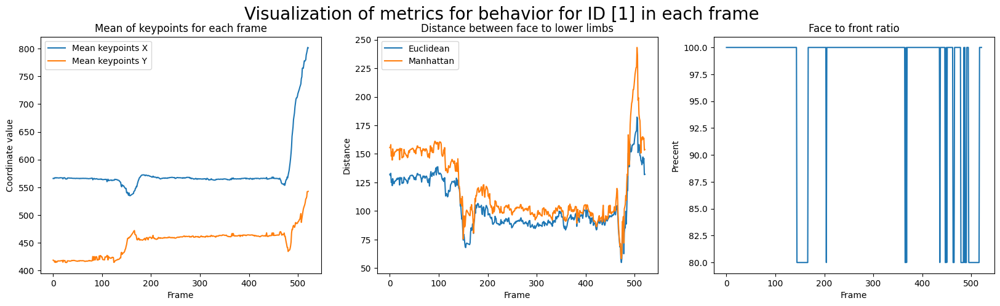

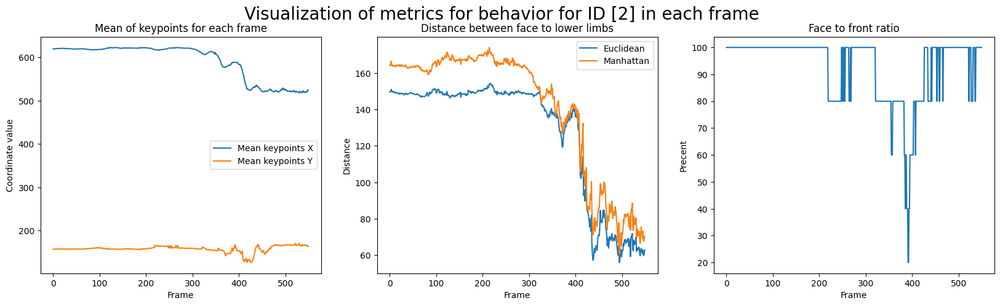

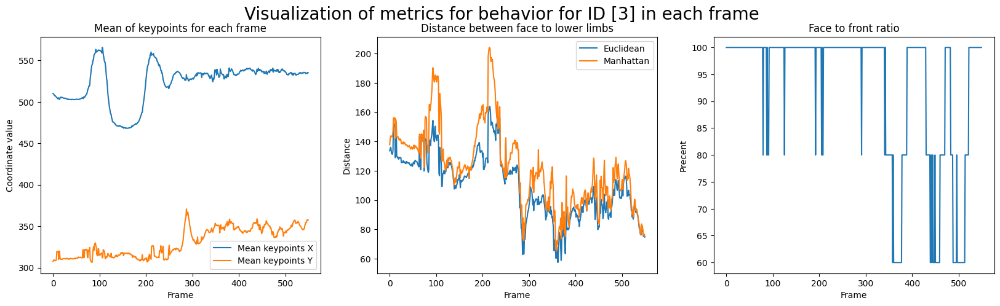

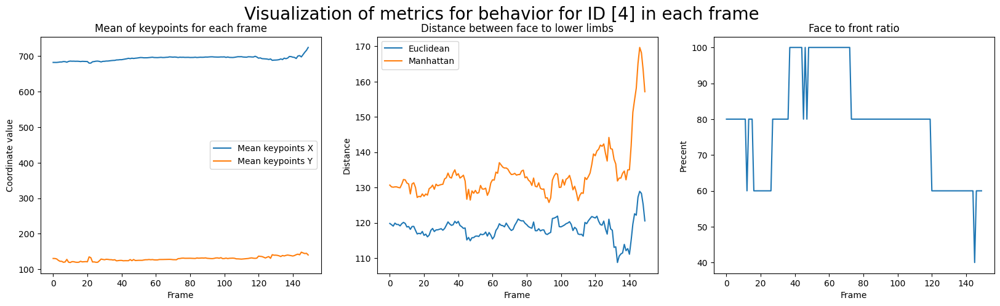

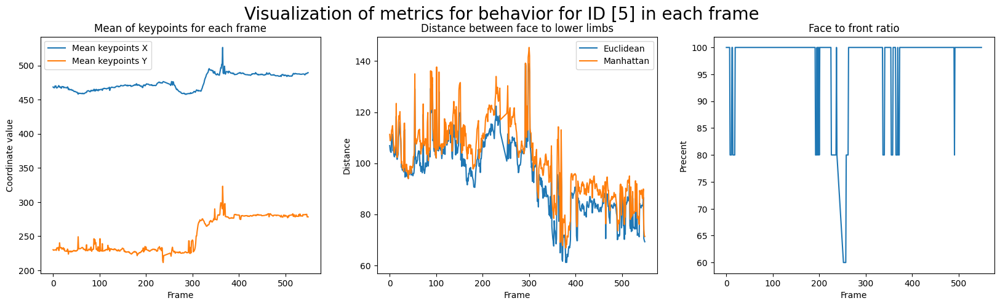

...

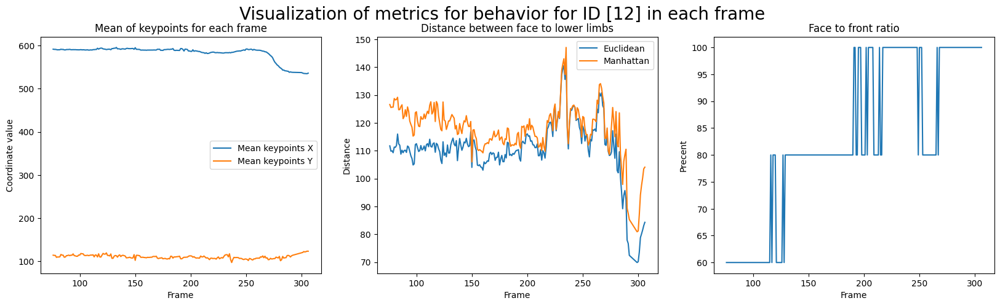

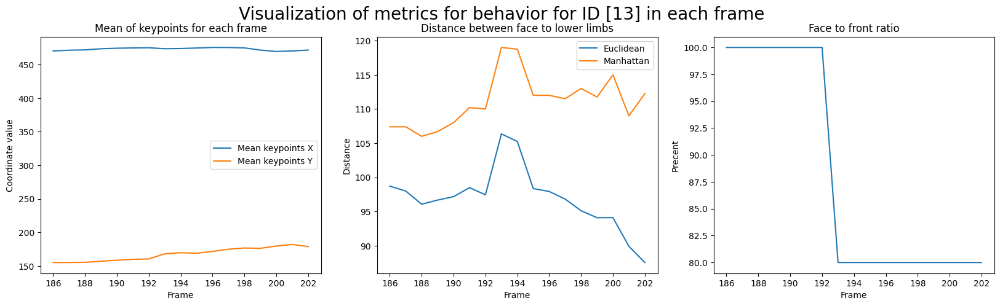

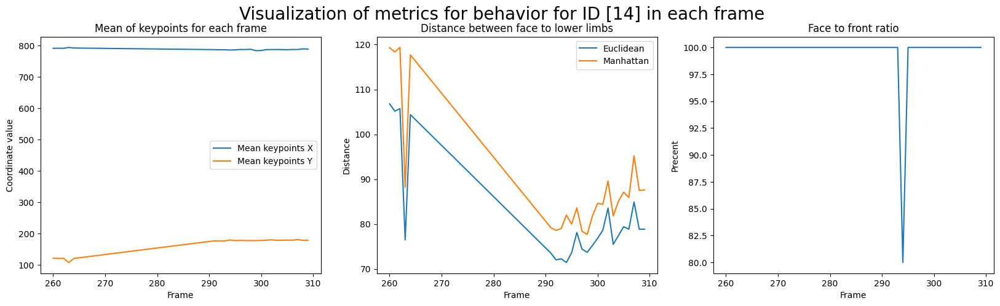

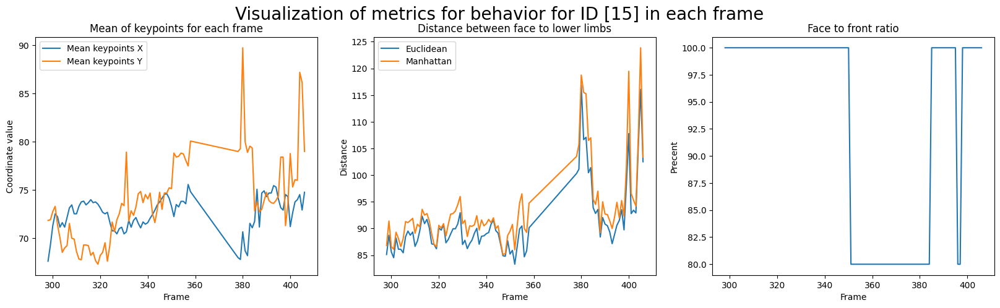

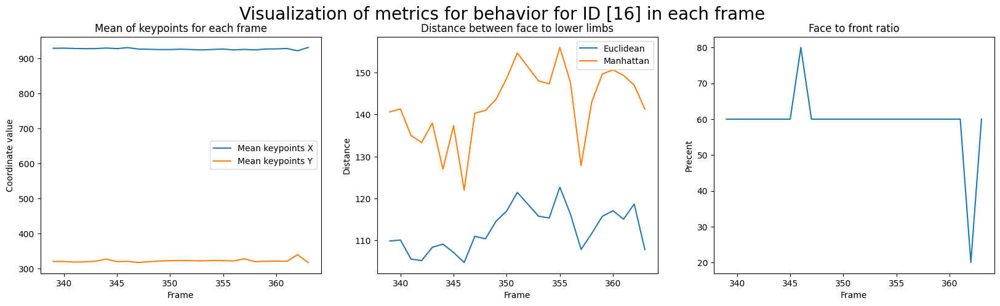

In [5]:
# plots
pose_plots.plot_individual_results(individual_scores_df)

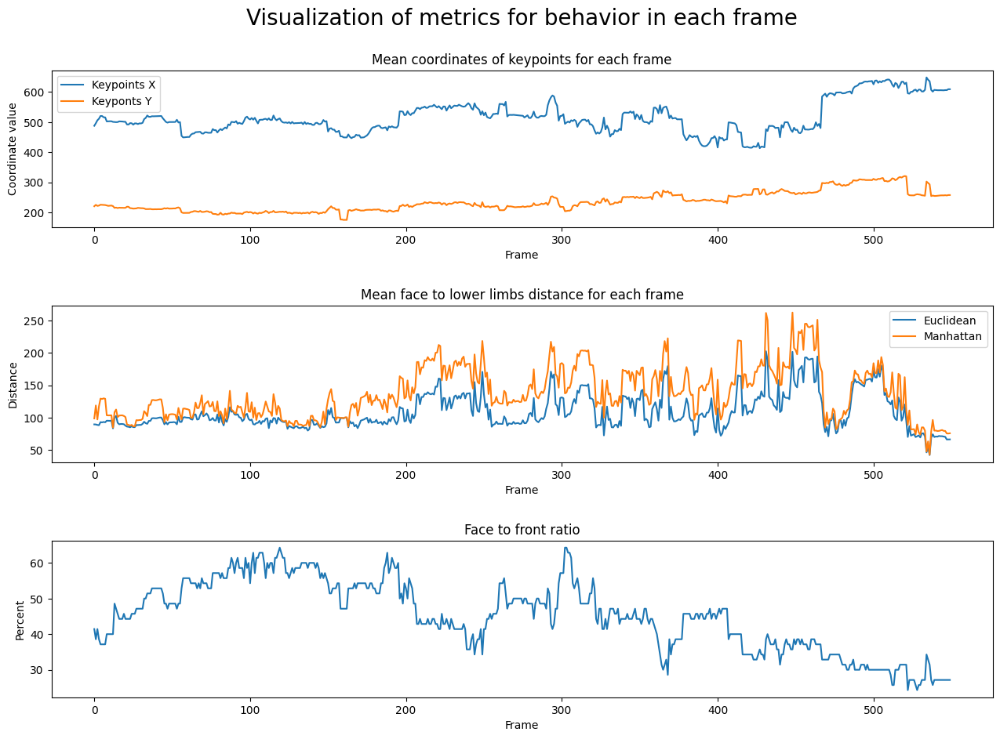

In [9]:
pose_plots.plot_total_metrics_each_frame(each_frame_scores)

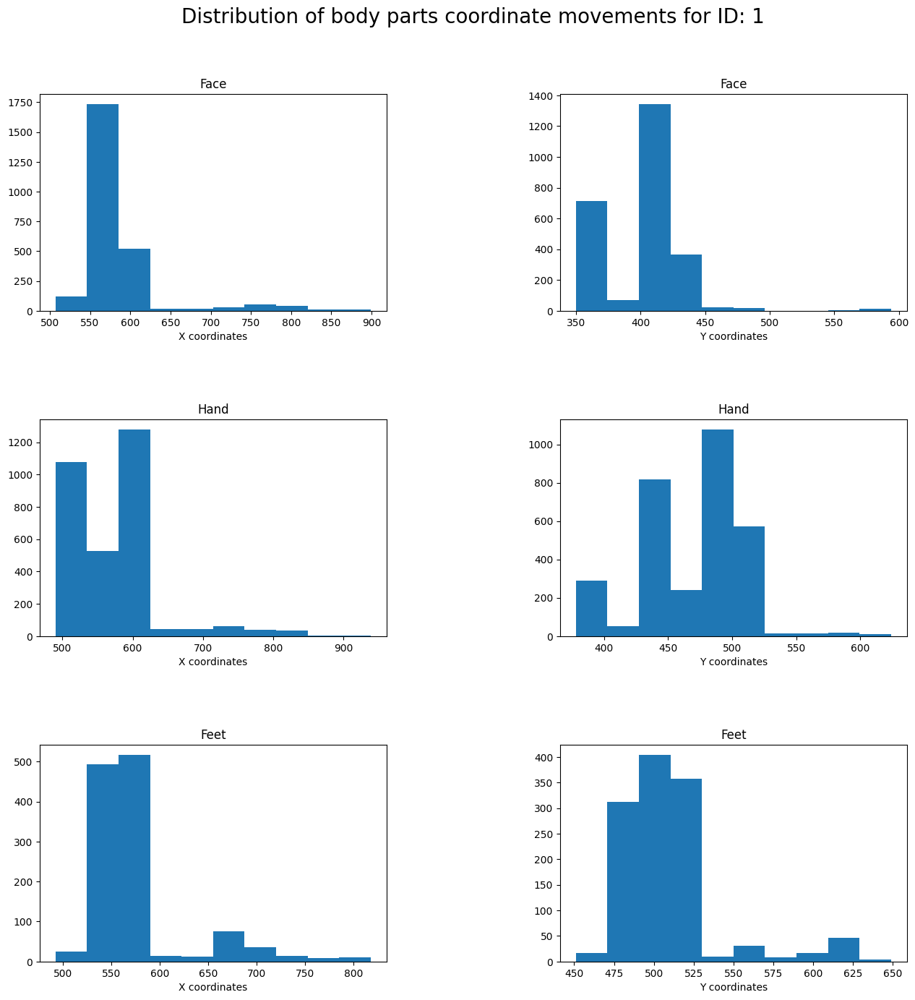

In [59]:
pose_plots.plot_total_metrics_each_id(full_coords_df)

## New func

In [193]:
def total_scores(df):
    
    fig,ax = plt.subplots(2,2)
    fig.set_figwidth(20)
    fig.set_figheight(10)

    # face to front
    inner_df = df[['ID','FaceToFrontEachID']].copy().drop_duplicates()
    inner_df['ID'] = inner_df['ID'].astype(str)
    inner_df = inner_df.sort_values('FaceToFrontEachID', ascending=False)

    ax[0][0].bar(inner_df['ID'],inner_df['FaceToFrontEachID'])
    ax[0][0].set_xlabel("ID")
    ax[0][0].set_ylabel("Percent")
    ax[0][0].set_title("Face to front percent")

    # std
    inner_df = df[['ID','STD_Pose_Y_EachID','STD_Pose_X_EachID']].copy().drop_duplicates()
    # inner_df = df[['ID','Mean_Pose_X_EachID','Mean_Pose_Y_EachID']].copy().drop_duplicates()
    inner_df['X_Y'] = round((inner_df['STD_Pose_Y_EachID'] + inner_df['STD_Pose_X_EachID'])/2,2)
    inner_df['ID'] = inner_df['ID'].astype(str)
    inner_df = inner_df.sort_values('X_Y', ascending=False)
    
    ax[0][1].bar(inner_df['ID'],inner_df['X_Y'])
    ax[0][1].set_xlabel("ID")
    ax[0][1].set_ylabel("Coordinate value")
    ax[0][1].set_title("Std deviation for each coordinate")
    
    # Euclidean
    inner_df = df[['ID','FaceToLoerLimbs_Euclidean']].copy().drop_duplicates()
    inner_df['ID'] = inner_df['ID'].astype(str)
    inner_df = inner_df.sort_values('FaceToLoerLimbs_Euclidean', ascending=False)

    ax[1][0].bar(inner_df['ID'],inner_df['FaceToLoerLimbs_Euclidean'])
    ax[1][0].set_xlabel("ID")
    ax[1][0].set_ylabel("Euclidean Distance")
    ax[1][0].set_title("Face to feet Euclidean distance")

    # Manhattan 	
    inner_df = df[['ID','FaceToLoerLimbs_Manhattan']].copy().drop_duplicates()
    inner_df['ID'] = inner_df['ID'].astype(str)
    inner_df = inner_df.sort_values('FaceToLoerLimbs_Manhattan', ascending=False)

    ax[1][1].bar(inner_df['ID'],inner_df['FaceToLoerLimbs_Manhattan'])
    ax[1][1].set_xlabel("ID")
    ax[1][1].set_ylabel("Distance")
    ax[1][1].set_title("Face to feet Manhattan distance")
    plt.show()



## vis

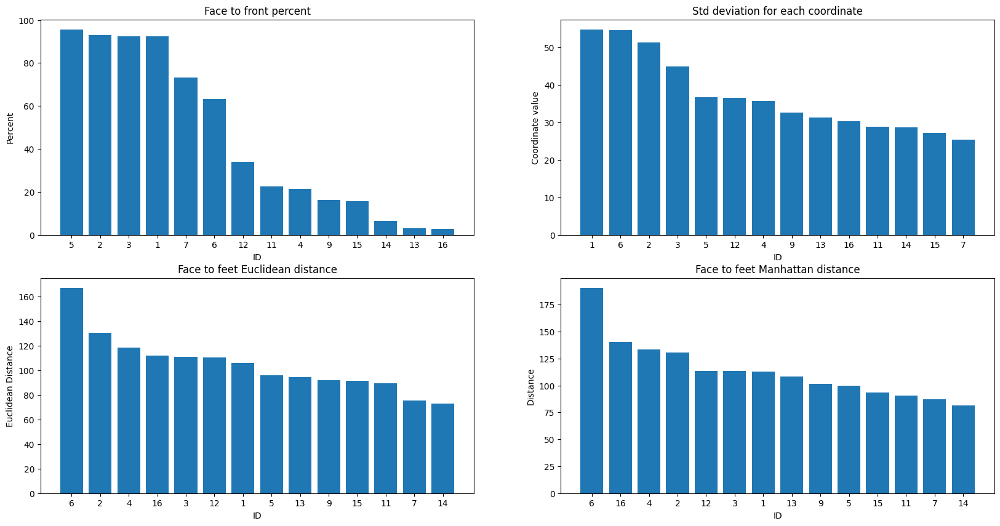

In [194]:
total_scores(each_id_scores)

## OpenPifPaf

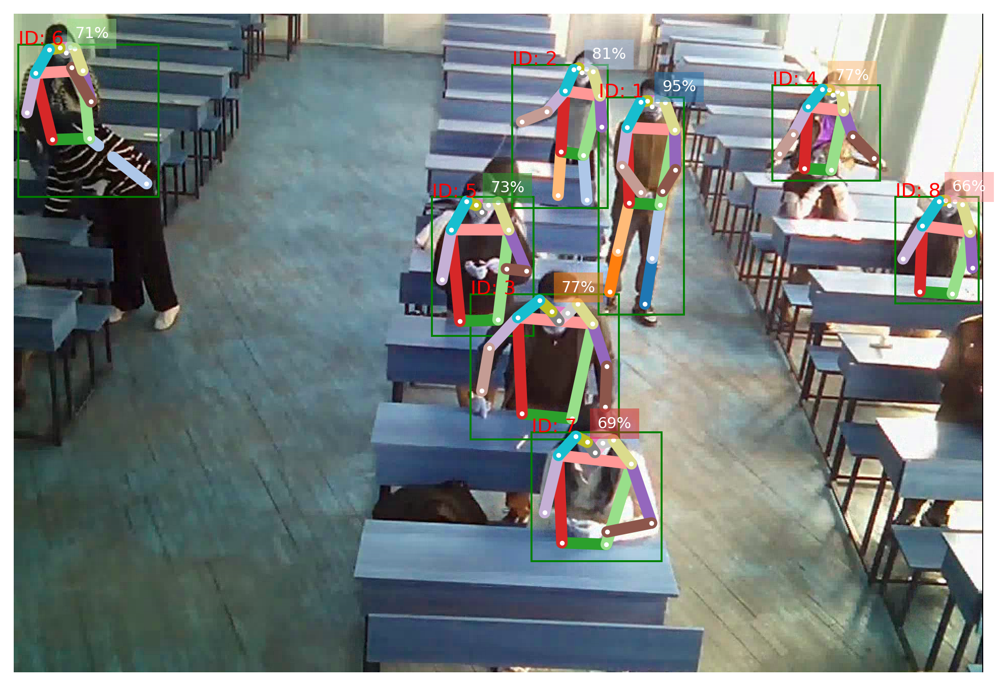

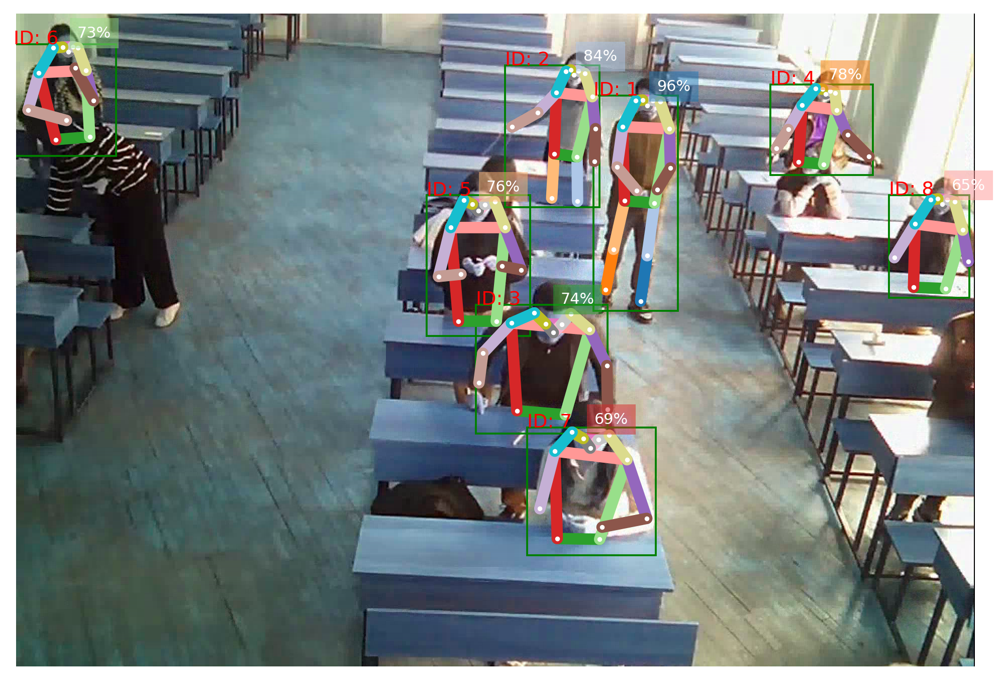

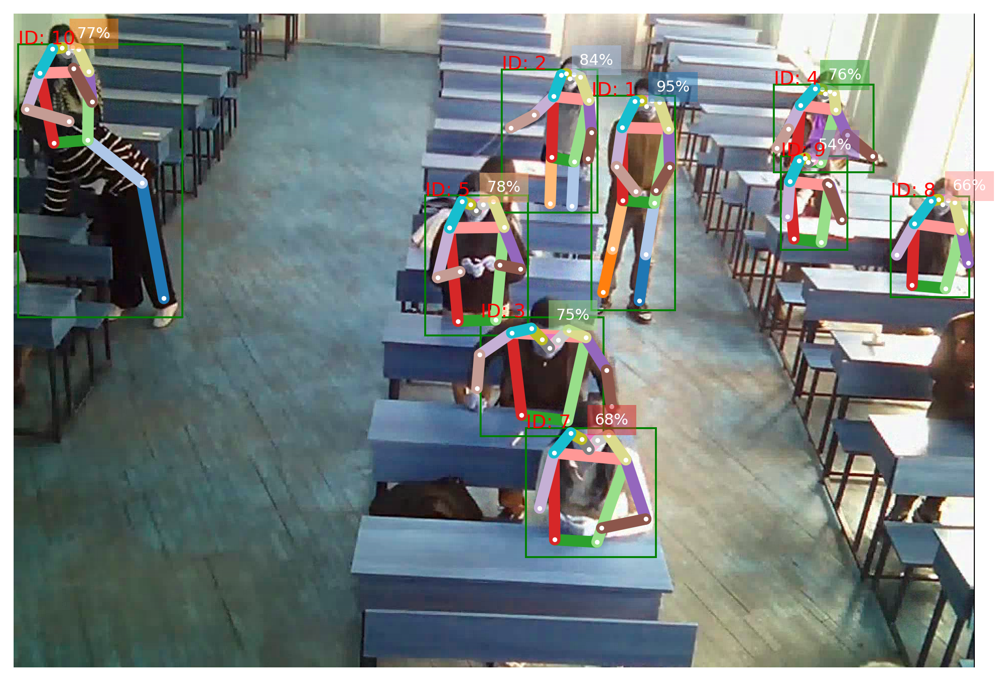

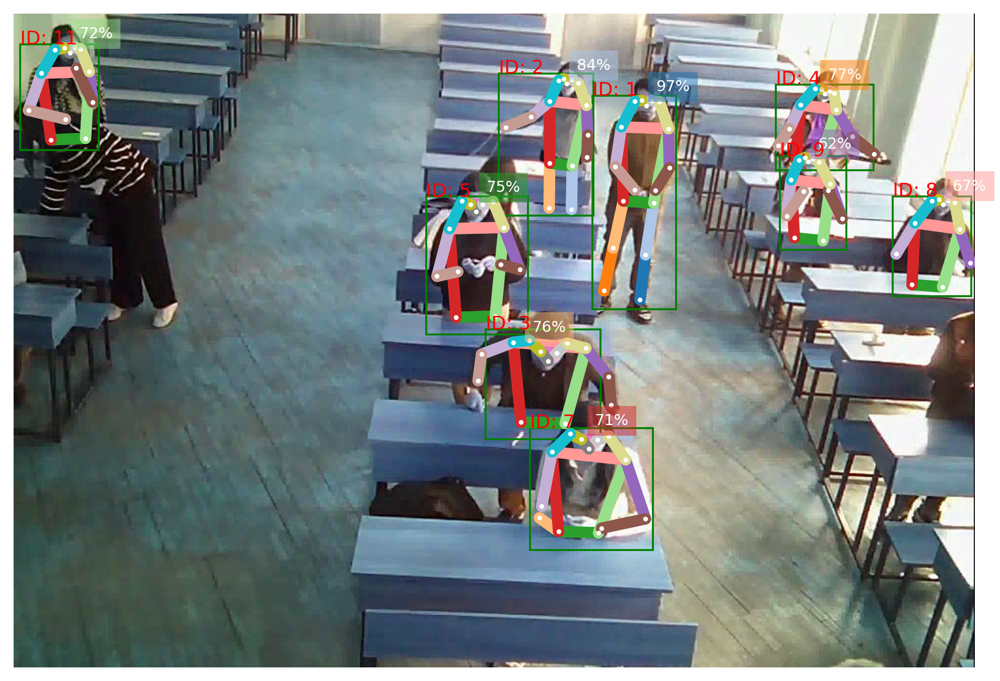

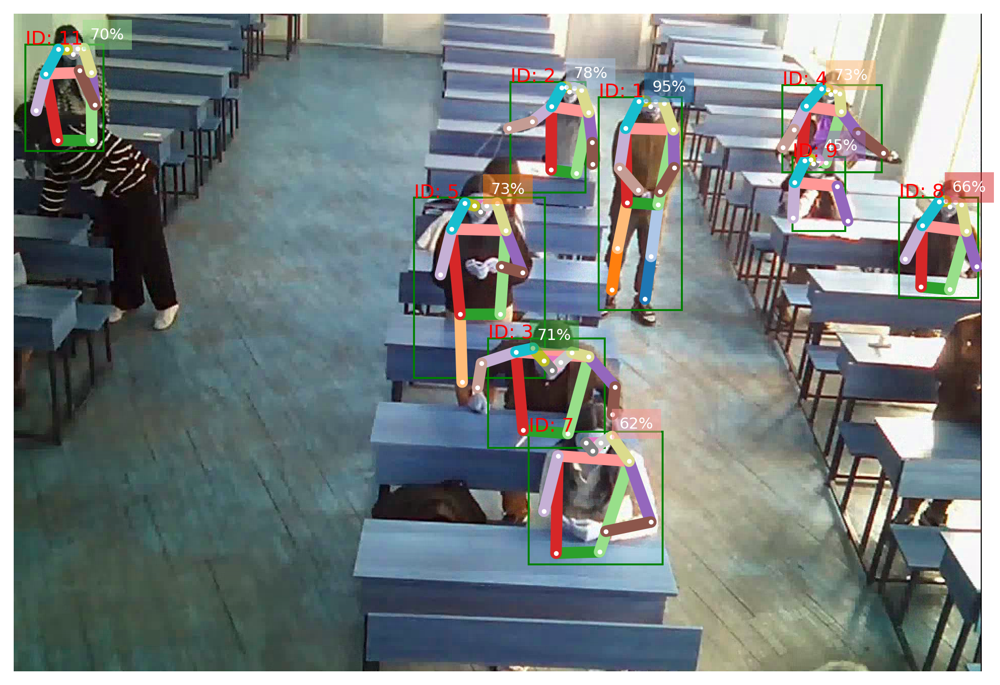

...

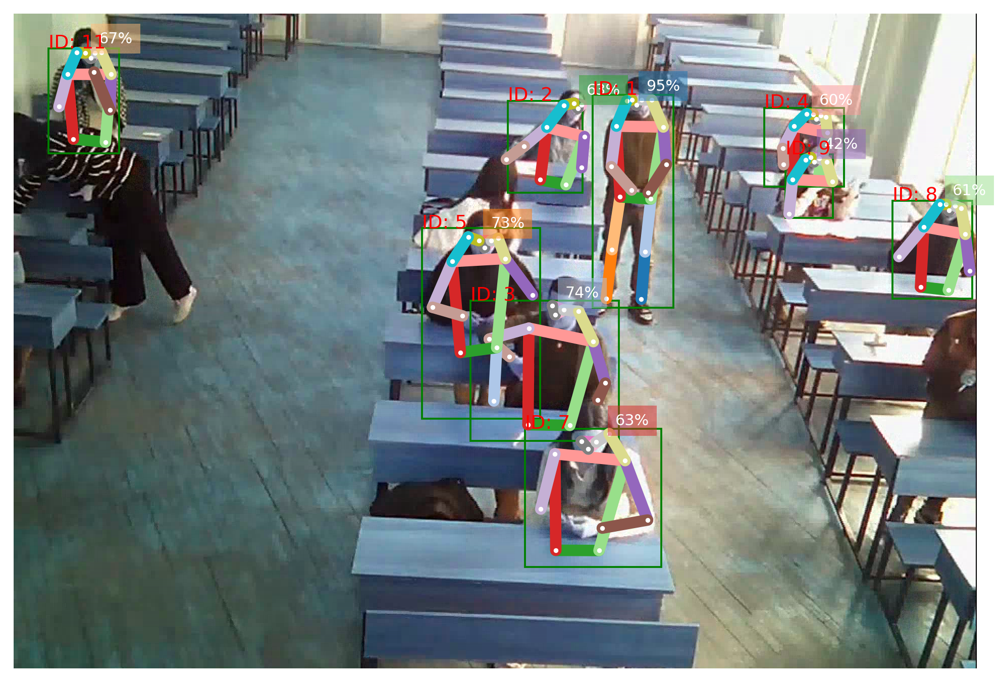

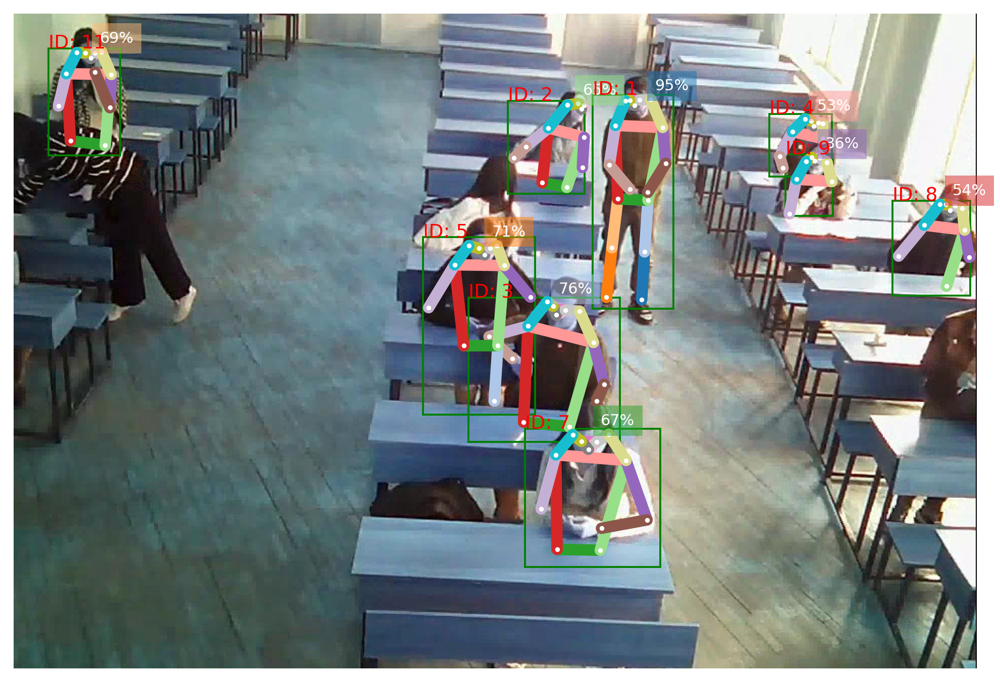

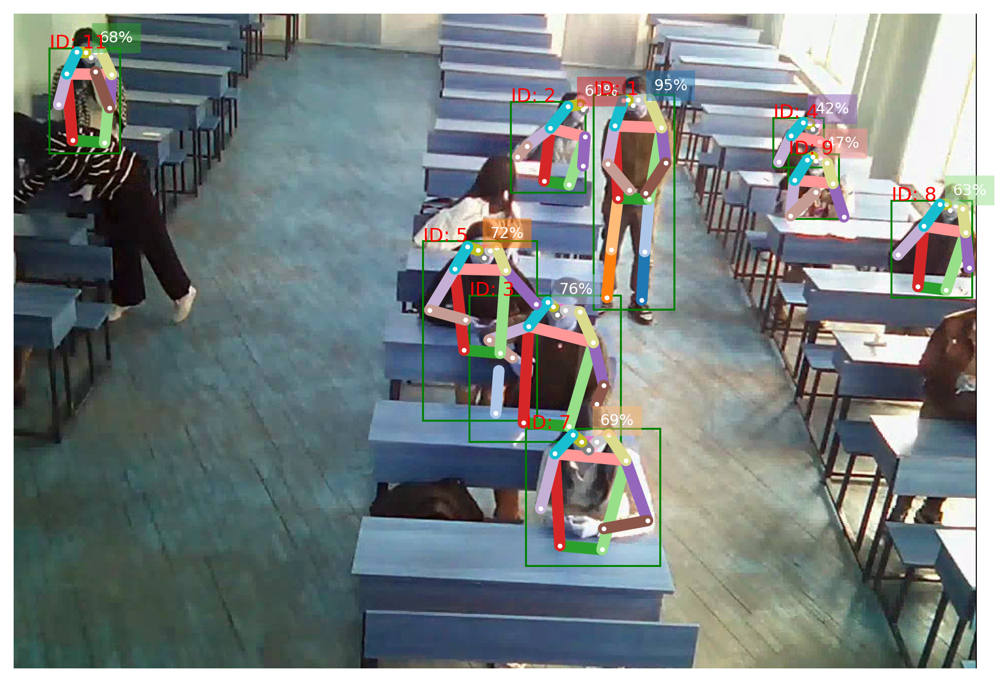

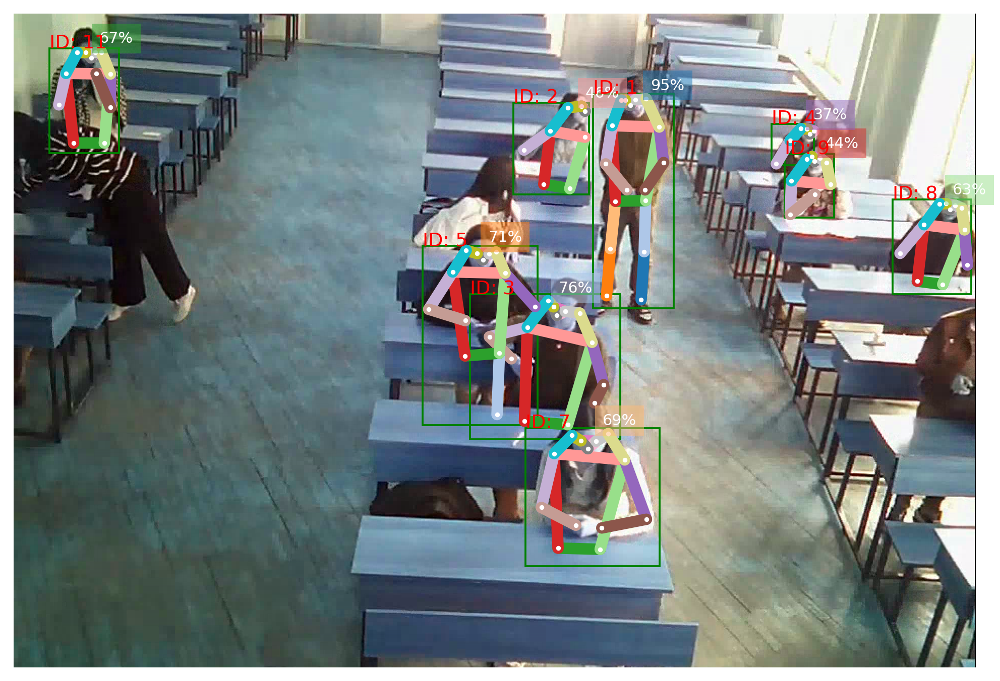

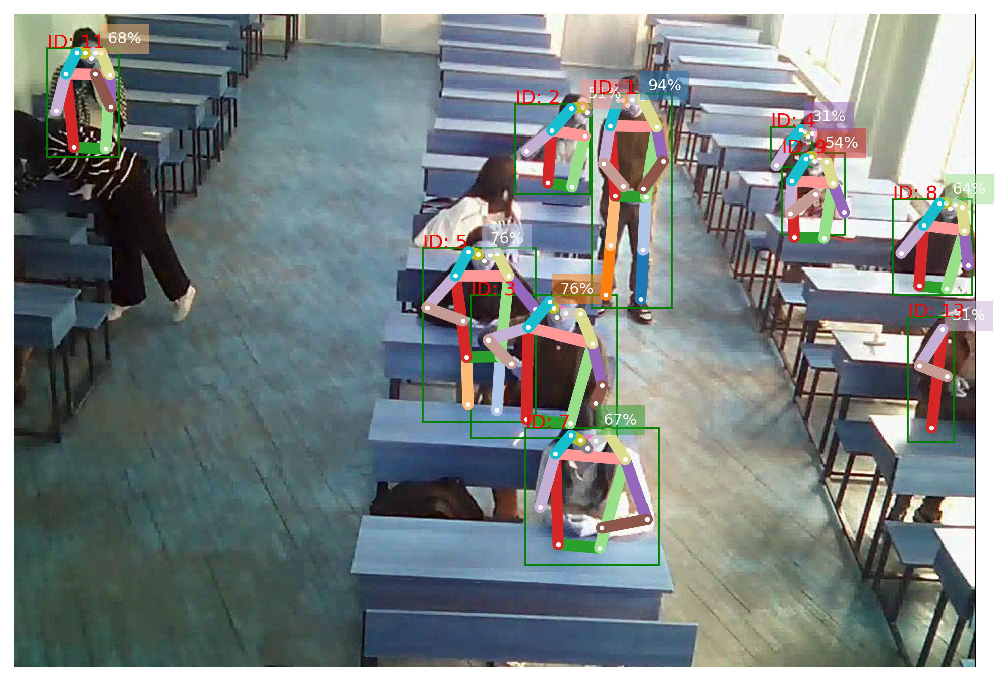

In [3]:
pose_detector = opp.Predictor(checkpoint="shufflenetv2k16")
cap = cv2.VideoCapture("../inference/video/YSU_20_sec.webm")

frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))


# text attributes
font = cv2.FONT_HERSHEY_SIMPLEX
# position = (50, 50)  # (x, y) coordinates
font_scale = 1
font_color = (255, 0, 0)  # BGR color
thickness = 6


rectangle_color = (0, 255, 0)  # BGR color
rectangle_thickness = 4

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('../runs/output_ysu_1_video.avi', fourcc, fps, (frame_width, frame_height))



tracker = DeepSort()

frame_id = 0
# 
# 1/0

while True:

    cat, frame = cap.read()

    if not cat:
        break

    


    frame_id +=1

    if frame_id < 280:
        continue


    image = Image.fromarray(frame)

    prediction,_,_ = pose_detector.pil_image(image)

    detections = []

    pose_pred_df = None
        
    ann_painter = opp.show.AnnotationPainter()
    
    with opp.show.image_canvas(image) as ax:

        for pred in prediction:
    
    
            score = pred.score
            cls = str(pred.category_id)
            bbox = [int(cord) for cord in pred.bbox()] # [x,y,w,h]
    
            pose_df = pd.DataFrame()
            pose_df[['bbox_x','bbox_y','bbox_w','bbox_h']] = bbox
    
            detections.append((bbox,score,cls))

            x,y,w,h = bbox

            top_left, bottom_right = (x+w,y+h),(x,y)
            # cv2.rectangle(frame, top_left, bottom_right, (0,0,255), rectangle_thickness)

            if pose_pred_df is None:
    
                pose_pred_df = pose_df.copy()
                continue
    
            pose_pred_df = pd.concat([pose_pred_df,pose_df])
            
        # track
        tracker.update_tracks(detections,frame=frame)
        tracks = tracker.tracker.tracks


        ann_painter.annotations(ax,prediction)
        # opp.show.AnimationFrame(
        # track_pred_df  None

        coords = [det[0] for det in detections]

        for track in tracks:

            x,y,w,h = [int(coord) for coord in track.to_ltwh()]

            # if [x,y,w,h] not in coords:
            #     continue

            
            ID = track.track_id
            top_left, bottom_right = (x+w,y+h),(x,y)
            cv2.putText(frame, "ID: " + ID, (x, y-5), font, font_scale, font_color, thickness)
            cv2.rectangle(frame, top_left, bottom_right, rectangle_color, rectangle_thickness)
            ax.text(x,y,"ID: "+str(ID), color='red')
            rect = plt.Rectangle((x,y),w,h,facecolor='none',edgecolor='green')

            ax.add_patch(rect)
        
        plt.show()

    out.write(frame)


    if frame_id == 300:
        break

    cat,frame = cap.read()
        

    # break